In [1]:
from AfricaBorderConflictRegression_functions import *

# 1) Grid Preperation

### Import Grid Cell Geodataframes
Save grid cells as geodataframe and add unique cell_ID and area (km squared)

grid_10km CRS - ESRI:102022
grid_25km CRS - ESRI:102022
grid_50km CRS - ESRI:102022
grid_100km CRS - ESRI:102022


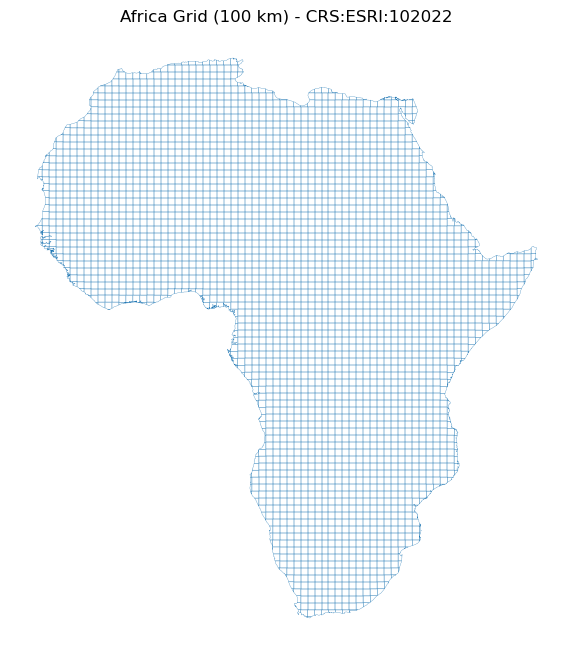

In [2]:
grid_path = "../Data/Grid_data/Africa_grid_102022.gpkg"
layers = fiona.listlayers(grid_path)
# import dataframes from geopackage layers with CRS set to Africa Equal-Area Conic (ESRI:102022)
if len(layers) == 4:
    for layer in layers:
        if layer == "africa_grid_10km":
            grid_10km = save_grid_gdf(grid_path, layer, "ESRI:102022")
        if layer == "africa_grid_25km":
            grid_25km = save_grid_gdf(grid_path, layer, "ESRI:102022")
        if layer == "africa_grid_50km":
            grid_50km = save_grid_gdf(grid_path, layer, "ESRI:102022")
        if layer == "africa_grid_100km":
            grid_100km = save_grid_gdf(grid_path, layer, "ESRI:102022")
else:
    print("Please import grid geopackage with 10km, 25km, 50km and 100km grid resolutions")
# verify crs
print(f"grid_10km CRS - {grid_10km.crs}")
print(f"grid_25km CRS - {grid_25km.crs}")
print(f"grid_50km CRS - {grid_50km.crs}")
print(f"grid_100km CRS - {grid_100km.crs}")
# Visualize grid cells
fig, ax = plt.subplots(figsize=(8, 8))
grid_100km.boundary.plot(ax=ax, linewidth=0.2)
ax.set_title(f"Africa Grid (100 km) - CRS:{grid_100km.crs}")
ax.set_axis_off()
plt.show()

### Identify coastal cells

This cell creates a simple “coastal cell” flag for each grid cell. The idea is that when we clip a square grid to the Africa land polygon, interior cells stay full-sized squares, but cells along the coastline get cut off and end up with a smaller area. The code defines a small function that compares each cell’s area_km2 to the expected full area for that grid size (for example, 10km × 10km = 100 km²). If a cell’s area is noticeably smaller than the full size (using a small tolerance to avoid floating-point quirks), it assigns is_coastal = 1; otherwise it assigns is_coastal = 0. It then runs that same rule for the 10km, 25km, 50km, and 100km grids using the appropriate full-cell area values, so each grid version gets a consistent coastal/non-coastal indicator.

In [3]:
grid_10km = coastal_binary(grid_10km, full_cell_area=100)
grid_25km = coastal_binary(grid_25km, full_cell_area=625)
grid_50km = coastal_binary(grid_50km, full_cell_area=2500)
grid_100km = coastal_binary(grid_100km, full_cell_area=10000)
grid_10km.head()

,id,left,top,right,bottom,row_index,col_index,geometry,cell_id,area_km2,is_coastal
0,241,-4.440354e+06,1.694190e+06,-4.430354e+06,1.684190e+06,240,0,"MULTIPOLYGON (((-4438668.496 1685614.099, -444...",0,40.913185,1
1,242,-4.440354e+06,1.684190e+06,-4.430354e+06,1.674190e+06,241,0,"MULTIPOLYGON (((-4431485.105 1676494.905, -443...",1,32.444992,1
2,1042,-4.430354e+06,1.704190e+06,-4.420354e+06,1.694190e+06,239,1,"MULTIPOLYGON (((-4420354.478 1694991.355, -442...",2,0.357439,1
3,1043,-4.430354e+06,1.694190e+06,-4.420354e+06,1.684190e+06,240,1,"MULTIPOLYGON (((-4422310.661 1685092.152, -442...",3,69.284336,1
4,1044,-4.430354e+06,1.684190e+06,-4.420354e+06,1.674190e+06,241,1,"MULTIPOLYGON (((-4430237.063 1683369.85, -4429...",4,9.327453,1


-----

# 2.1) Compute Conflict Counts

-----

This cell calculates how many ACLED conflict events fall inside each grid cell, and then stores that count as a new column in the grid. It starts by loading the ACLED points (which are in latitude/longitude) and reprojecting them into the same projected CRS as the grid (ESRI:102022) so the layers line up correctly. Next, it fixes any invalid grid polygons so the spatial operations don’t fail. Then it does a spatial join so every conflict point is matched to the grid cell it falls inside, counts how many points matched each cell, and attaches those counts back onto the grid. Cells with no events are filled with 0. At the end it prints quick checks (total points, matched, unmatched, and the summed grid counts) to confirm nothing was lost, and it runs the same process for the 10km, 25km, 50km, and 100km grids so each grid version gets its own incident-count column.

In [4]:
conflict_gdf = import_geopackage("../Data/Conflict_data/ACLED_2020-2024_conflict-data_africa_4326.gpkg")
conflict_gdf = set_crs(conflict_gdf, "ESRI:102022")

### Total conflict incidents count

In [5]:
grid_10km = compute_conflict_counts_aggregated(grid_10km, conflict_gdf)
grid_25km = compute_conflict_counts_aggregated(grid_25km, conflict_gdf)
grid_50km = compute_conflict_counts_aggregated(grid_50km, conflict_gdf)
grid_100km = compute_conflict_counts_aggregated(grid_100km, conflict_gdf)

Total ACLED points: 197140
Matched to a cell: 197140
Unmatched: 0
-----
Total ACLED points: 197140
Matched to a cell: 197140
Unmatched: 0
-----
Total ACLED points: 197140
Matched to a cell: 197140
Unmatched: 0
-----
Total ACLED points: 197140
Matched to a cell: 197140
Unmatched: 0
-----


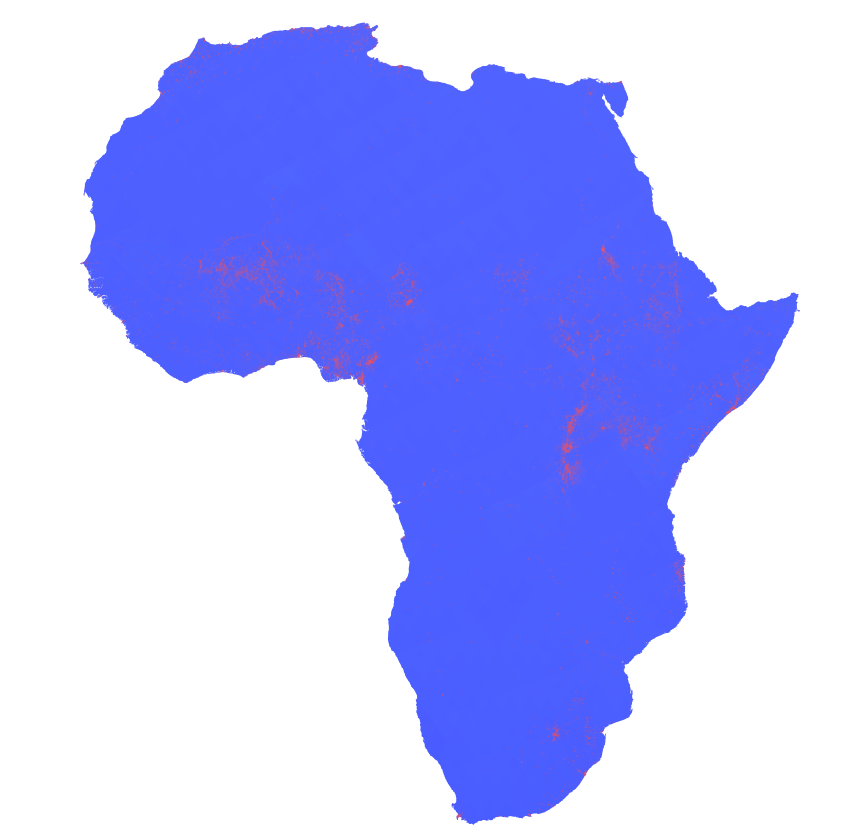

In [6]:
display(IPyImage(filename="../QGIS/screenshots/Count_violence_all.png"))

### Disaggregated conflict incidents count

This cell goes one step further than a single total count by calculating separate counts for each type of conflict event inside every grid cell. It loads the ACLED points and reprojects them to match the grid so the layers align, then fixes any invalid grid polygons. Next, it assigns each ACLED point to the grid cell it falls within (spatial join), but this time it keeps the event category field as well. It then counts points by (grid cell, event type) and reshapes the results so each event type becomes its own column (for example, one column for battles, one for protests, etc.). The code also cleans up the column names so they are consistent and easy to use later, joins these new event-type columns back onto the grid, replaces missing values with zeros (meaning “no events of this type in this cell”), and finally creates a count_total column by summing across all event-type columns so we still have an overall total for each cell.

In [7]:
grid_10km = compute_conflict_counts_disaggregated(grid_10km, conflict_gdf)
grid_25km = compute_conflict_counts_disaggregated(grid_25km, conflict_gdf)
grid_50km = compute_conflict_counts_disaggregated(grid_50km, conflict_gdf)
grid_100km = compute_conflict_counts_disaggregated(grid_100km, conflict_gdf)

### Further subevent category disaggregation conflict incidents count

In [8]:
grid_10km = compute_conflict_counts_subeventcategory(grid_10km, conflict_gdf)
grid_25km = compute_conflict_counts_subeventcategory(grid_25km, conflict_gdf)
grid_50km = compute_conflict_counts_subeventcategory(grid_50km, conflict_gdf)
grid_100km = compute_conflict_counts_subeventcategory(grid_100km, conflict_gdf)

In [9]:
print(grid_10km[[c for c in grid_10km.columns if c.startswith("count_")]].sum().sort_values(ascending=False))

count_total_aggregated                       197140
count_total_disaggregated                    197140
count_total_subevent                         197140
count_protests                                49163
count_violence_against_civilians              47681
count_battles                                 46384
count_armed_clash                             44526
count_peaceful_protest                        44420
count_attack                                  36229
count_strategic_developments                  22673
count_riots                                   17904
count_explosions_remote_violence              13335
count_mob_violence                            10785
count_looting_property_destruction            10331
count_abduction_forced_disappearance          10006
count_violent_demonstration                    7119
count_air_drone_strike                         4768
count_remote_explosive_landmine_ied            4473
count_other                                    3989
count_protes

### Compute fatalities per grid cell

In [10]:
grid_10km = compute_fatalities(grid_10km, conflict_gdf)
grid_25km = compute_fatalities(grid_25km, conflict_gdf)
grid_50km = compute_fatalities(grid_50km, conflict_gdf)
grid_100km = compute_fatalities(grid_100km, conflict_gdf)

Total fatalities in points: 269353
Total fatalities in grid: 269353
-----
Total fatalities in points: 269353
Total fatalities in grid: 269353
-----
Total fatalities in points: 269353
Total fatalities in grid: 269353
-----
Total fatalities in points: 269353
Total fatalities in grid: 269353
-----


-----

# 2.2) Compute Controls

-----

### Compute estimated population per grid cell

This cell estimates the total population inside each grid cell using a population density raster. It loads the population density GeoTIFF and checks what value represents “no data” so missing pixels are handled correctly. Because the raster is in latitude/longitude and the grid is in a projected CRS, the raster is reprojected into the same CRS as the grid so pixel sizes are in meters and pixel areas are consistent. The code then converts density values into “people per pixel” by multiplying the density by the pixel’s area (converted to km²). After that, it calculates population per grid cell by summing the “people per pixel” values inside each polygon. Since there are many grid cells, it processes them in chunks to avoid running out of memory or locking up the notebook. Finally, it rounds the results to whole people, saves them in a new pop_est column, and repeats the same population-estimation workflow for the 10km, 25km, 50km, and 100km grid layers.

In [11]:
grid_10km = compute_population_estimate(grid_10km, "../Data/Controls_data/population_density_102022.tif")
grid_25km = compute_population_estimate(grid_25km, "../Data/Controls_data/population_density_102022.tif")
grid_50km = compute_population_estimate(grid_50km, "../Data/Controls_data/population_density_102022.tif")
grid_100km = compute_population_estimate(grid_100km, "../Data/Controls_data/population_density_102022.tif")

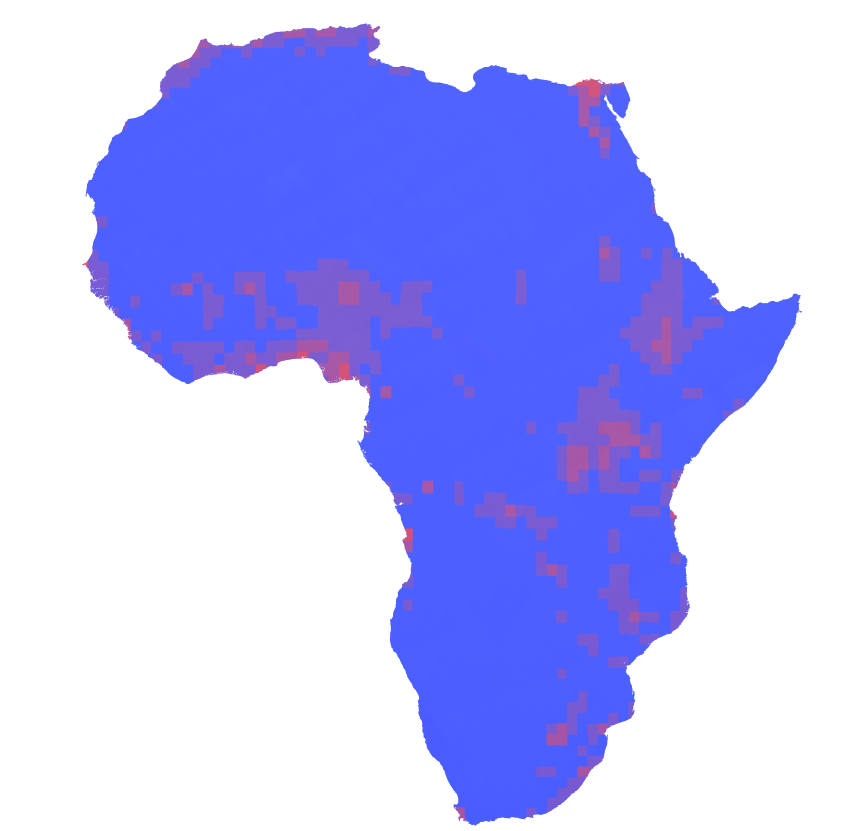

In [12]:
display(IPyImage(filename="../QGIS/screenshots/Control_population.png"))

### Compute majority land cover per grid cell

In [13]:
grid_10km = compute_landcover_majority(grid_10km, "../Data/Controls_data/landcover_1kmX1km_102022.tif")
grid_25km = compute_landcover_majority(grid_25km, "../Data/Controls_data/landcover_1kmX1km_102022.tif")
grid_50km = compute_landcover_majority(grid_50km, "../Data/Controls_data/landcover_1kmX1km_102022.tif")
grid_100km = compute_landcover_majority(grid_100km, "../Data/Controls_data/landcover_1kmX1km_102022.tif")

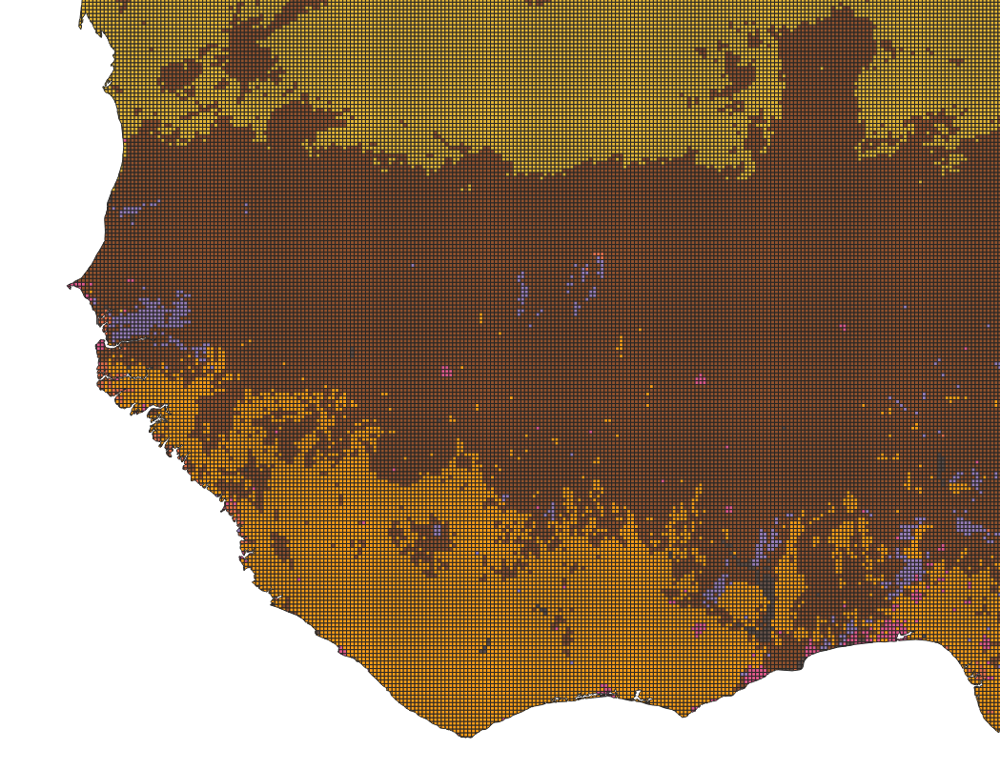

In [14]:
display(IPyImage(filename="../QGIS/screenshots/Control_landcover.png"))

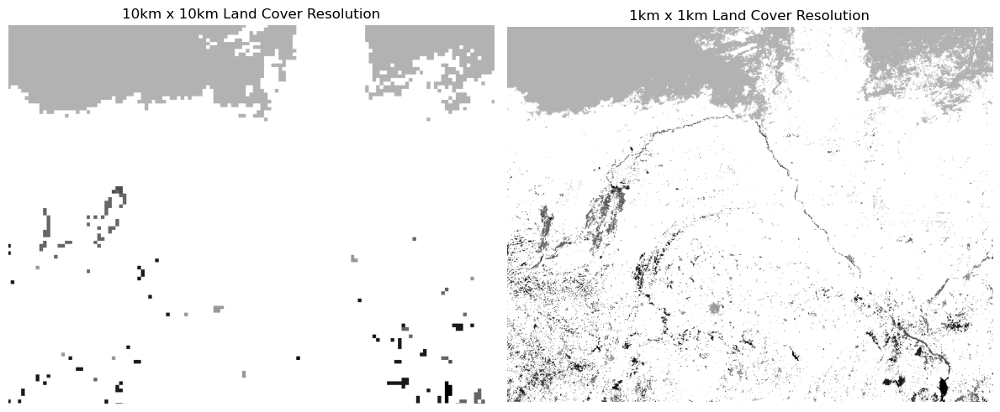

In [15]:
img1 = PILImage.open("../QGIS/screenshots/Controls_landcoverview2.png")
img2 = PILImage.open("../QGIS/screenshots/Controls_landcoverview1.png")
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img1)
axes[0].axis("off")
axes[0].set_title("10km x 10km Land Cover Resolution")
axes[1].imshow(img2)
axes[1].axis("off")
axes[1].set_title("1km x 1km Land Cover Resolution")
plt.tight_layout()
plt.show()

### Compute total road km passing through each grid cell

This cell calculates how many kilometers of roads fall inside each grid cell. It starts by loading the roads layer (stored in latitude/longitude) and then reprojects both the roads and the grid into a distance-friendly CRS (ESRI:102023) so that road lengths are measured in meters and can be converted to kilometers. It removes any missing or empty line geometries and fixes invalid shapes so the overlay operation won’t fail. Next, it intersects the roads with the grid so each road is “cut” into smaller segments that fit inside individual grid cells. It measures the length of each clipped segment, converts meters to kilometers, and then sums those segment lengths for each grid cell. Finally, it attaches the result back onto the original grid as a new road_km column, filling empty cells with 0 (meaning no roads in that cell), and runs the same procedure for the 10km, 25km, 50km, and 100km grids.

In [16]:
grid_10km = compute_pavedroadkm(grid_10km, target_crs="ESRI:102023")
grid_25km = compute_pavedroadkm(grid_25km, target_crs="ESRI:102023")
grid_50km = compute_pavedroadkm(grid_50km, target_crs="ESRI:102023")
grid_100km = compute_pavedroadkm(grid_100km, target_crs="ESRI:102023")

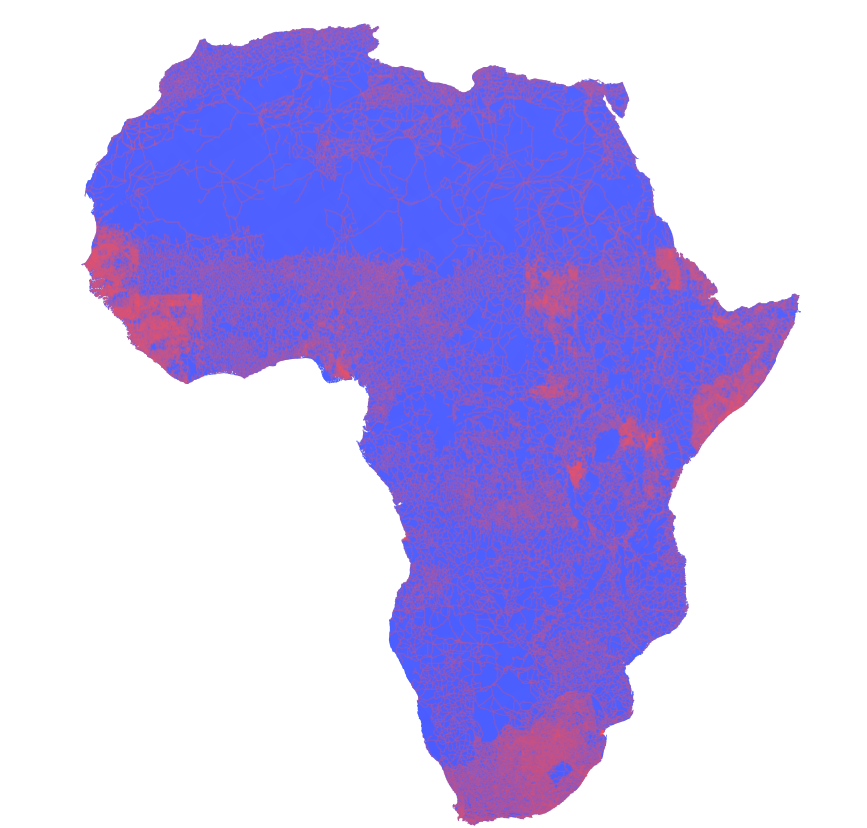

In [17]:
display(IPyImage(filename="../QGIS/screenshots/Control_roads.png"))

# 2.3) Compute autocorrelation clusters

This step computes spatial autocorrelation for the conflict totals and assigns each grid cell a LISA cluster label (HH, HL, LH, or LL). It starts by making a copy of the grid, fixing any invalid polygons, and replacing missing values in count_total with zero so every cell can be included. Because conflict counts are extremely skewed (many zeros and a few hotspots), it applies a log transform (log1p) so the autocorrelation results are not dominated by a small number of extreme values. Next, it builds a spatial “neighbors” structure using Queen contiguity, meaning each cell is considered a neighbor if it touches another cell by an edge or even a corner, and then row-standardizes those weights. The code then calculates Global Moran’s I to summarize whether the entire map shows clustering overall, and Local Moran’s I (LISA) to identify where clustering happens cell-by-cell. Finally, it converts each cell’s LISA quadrant into a human-readable cluster label (HH, HL, LH, LL), and optionally marks cells as “Not signif” when the local p-value is above the chosen significance level, so the final output can be mapped as cluster categories rather than raw statistics.

In [18]:
print("10km grid autocorrelation")
grid_10km = compute_autocorrelation(grid_10km)
print("-----")
print("25km grid autocorrelation")
grid_25km = compute_autocorrelation(grid_25km)
print("-----")
print("50km grid autocorrelation")
grid_50km = compute_autocorrelation(grid_50km)
print("-----")
print("100km grid autocorrelation")
grid_100km = compute_autocorrelation(grid_100km)

10km grid autocorrelation
Global Moran's I: 0.3562143888850849
p-value (sim): 0.001
-----
25km grid autocorrelation
Global Moran's I: 0.5272709505816391
p-value (sim): 0.001
-----
50km grid autocorrelation
Global Moran's I: 0.6225504563600819
p-value (sim): 0.001
-----
100km grid autocorrelation
Global Moran's I: 0.6548429321411153
p-value (sim): 0.001


In [20]:
# Generate interactive cluster map
from branca.element import Element
cluster_heatmap_gdf = grid_25km.copy()
# 1) Reproject to WGS84 for Leaflet
gdf_wgs = cluster_heatmap_gdf.to_crs(epsg=4326).copy()
# 2) Cluster categories and colors
clusters_to_keep = ["HH", "LL", "HL", "LH"]
cluster_palette = {"HH": "#d7191c","LL": "#2b83ba","HL": "#fdae61","LH": "#80c4cf"}
attribute = "lisa_label"
# Keep only rows with valid cluster labels
layer_gdf = gdf_wgs[gdf_wgs[attribute].isin(clusters_to_keep)].copy()
# 3) Style + highlight
def style_function(feature):
    cluster = feature["properties"].get(attribute)
    color = cluster_palette.get(cluster, "#cccccc")
    return {"fillColor": color,"color": "white","weight": 0.25,"fillOpacity": 0.6,}
highlight_function = lambda feat: {"weight": 2, "color": "black", "fillOpacity": 0.85}
# 4) Map center
centroid = layer_gdf.geometry.unary_union.centroid
center_lat, center_lon = centroid.y, centroid.x
# 5) Build map (single basemap)
final_map = folium.Map(location=[center_lat, center_lon],zoom_start=11,tiles="CartoDB Voyager")
# 6) Add the ONE layer
folium.GeoJson(data=layer_gdf,name="LISA clusters",style_function=style_function,highlight_function=highlight_function,tooltip=folium.GeoJsonTooltip(fields=[attribute],aliases=["LISA:"],localize=True,sticky=True,),).add_to(final_map)
# 7) Title + legend (optional)
title_html = """
<div style="position:fixed; top:10px; left:50%; transform:translateX(-50%);
z-index:9999; background-color:white; padding:6px 12px; border:1px solid #ccc;
border-radius:4px; font-size:14px;">
<b>Local Indicators of Spatial Association (LISA) Clusters - Africa Conflict Heatmap</b>
</div>
"""
legend_html = """
<div style="position:fixed; bottom:30px; right:10px; z-index:9999; background-color:white;
padding:8px 10px; border:1px solid #ccc; border-radius:4px; font-size:12px;">
<b>LISA clusters</b><br>
<i style="background:#d7191c; width:12px; height:12px; float:left; margin-right:6px; opacity:0.7;"></i>High-High<br>
<i style="background:#2b83ba; width:12px; height:12px; float:left; margin-right:6px; opacity:0.7;"></i>Low-Low<br>
<i style="background:#fdae61; width:12px; height:12px; float:left; margin-right:6px; opacity:0.7;"></i>High-Low<br>
<i style="background:#80c4cf; width:12px; height:12px; float:left; margin-right:6px; opacity:0.7;"></i>Low-High<br>
<i style="background:#808080; width:12px; height:12px; float:left; margin-right:6px; opacity:0.7;"></i>Not signif<br>
</div>
"""
final_map.get_root().html.add_child(Element(title_html))
final_map.get_root().html.add_child(Element(legend_html))
# 8) Export and display
final_map.save("LISA_interactive_map.html")
final_map

# 2.4) Compute distances from borders

This step adds a “distance to border” variable for each grid cell, which we can use as a key predictor in our regression. It defines a reusable function that takes a grid layer and a specific border dataset (national, colonial, religious, or ethnic) and then computes the distance from each cell’s centroid to the nearest border line. The function loads the border lines, creates centroid points from the grid cells, and reprojects both the centroids and the borders into a distance-friendly projected CRS (ESRI:102023) so the distance results are in meters. It also cleans the border data by removing empty geometries and fixing invalid shapes to prevent spatial errors. Next, it uses a “nearest neighbor” spatial join to find the closest border feature to each centroid and records that distance. Because ties or duplicated matches can happen, it collapses the results so that each grid cell keeps one distance value (the minimum distance). Finally, it attaches the distance back onto the grid as new columns—one in meters and one converted to kilometers—so we end up with a consistent distance-to-border metric for each grid cell and for each type of border we run through the function.

In [21]:
borders_list = ["national_borders_102023", "colonial_borders_102023", "religious_borders_102023", "ethnic_borders_102023"]
for border in borders_list:
    grid_10km = compute_dist_to_border(grid_10km, border, target_crs="ESRI:102023")
    grid_25km = compute_dist_to_border(grid_25km, border, target_crs="ESRI:102023")
    grid_50km = compute_dist_to_border(grid_50km, border, target_crs="ESRI:102023")
    grid_100km = compute_dist_to_border(grid_100km, border, target_crs="ESRI:102023")

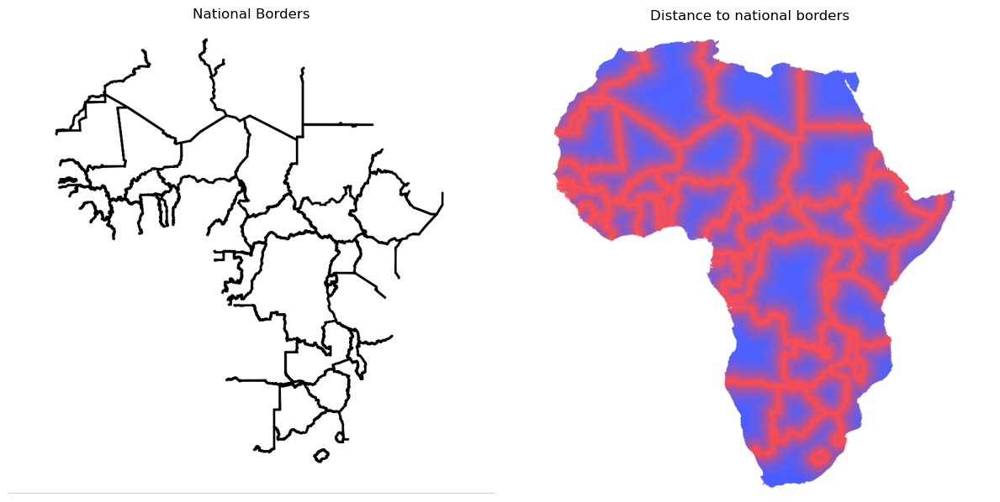

In [22]:
img1 = PILImage.open("../QGIS/screenshots/Lines-national-borders.png")
img2 = PILImage.open("../QGIS/screenshots/Dist-national-borders.png")
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img1)
axes[0].axis("off")
axes[0].set_title("National Borders")
axes[1].imshow(img2)
axes[1].axis("off")
axes[1].set_title("Distance to national borders")
plt.tight_layout()
plt.show()

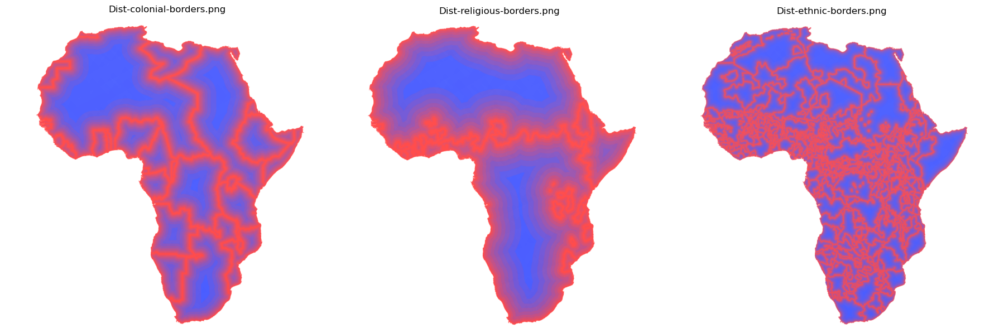

In [23]:
paths = ["../QGIS/screenshots/Dist-colonial-borders.png","../QGIS/screenshots/Dist-religious-borders.png","../QGIS/screenshots/Dist-ethnic-borders.png",]
imgs = [PILImage.open(p) for p in paths]
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
for ax, img, title in zip(axes, imgs, [p.split("/")[-1] for p in paths]):
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(title)
plt.tight_layout()
plt.show()

# 2.5) Export full dataset

In [24]:
grid_list = {"grid_10km_102022": grid_10km, "grid_25km_102022": grid_25km, "grid_50km_102022": grid_50km, "grid_100km_102022": grid_100km}
for layer, gdf in grid_list.items():
    export_geopackage(gdf, "../Data/Regression_data/Africa-border-conflict_regression-data_102022.gpkg", layer)

-----

# 3) Regression Analysis

-----

### OLS Regression - no controls

In [25]:
grid = grid_100km.copy()
dist_cols = ["dist_national_borders_102023_km","dist_colonial_borders_102023_km","dist_religious_borders_102023_km","dist_ethnic_borders_102023_km",]
y_col = "count_total_aggregated"
models = {}
for d in dist_cols:
    df = grid[[d, y_col]].copy()
    df = df.replace([np.inf, -np.inf], np.nan).dropna()
    df["km_closer"] = (-df[d].astype(float)) / 100.0   # <-- now per 100 km closer
    y = df[y_col].astype(float)
    X = sm.add_constant(df["km_closer"])
    m = sm.OLS(y, X).fit(cov_type="HC1")
    models[d] = m
    print("\n" + "="*95)
    print(f"OLS Regression: increase in conflict count per 100km closer to border) | {d}")
    print("="*95)
    print(m.summary().tables[1])


OLS Regression: increase in conflict count per 100km closer to border) | dist_national_borders_102023_km
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         70.4789      5.999     11.748      0.000      58.720      82.238
km_closer      4.2268      3.425      1.234      0.217      -2.487      10.940

OLS Regression: increase in conflict count per 100km closer to border) | dist_colonial_borders_102023_km
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         80.2020      6.125     13.093      0.000      68.196      92.208
km_closer      6.5490      1.474      4.442      0.000       3.659       9.439

OLS Regression: increase in conflict count per 100km closer to border) | dist_religious_borders_102023_km
                 coef    std err          z      

### OLS Regression - with controls

In [26]:
grid = grid_100km.copy()
dist_cols = ["dist_national_borders_102023_km","dist_colonial_borders_102023_km","dist_religious_borders_102023_km","dist_ethnic_borders_102023_km"]
y_col = "count_total_aggregated"
models = {}
for d in dist_cols:
    cols = [d, y_col, "is_coastal", "pop_est", "road_km", "landcover_majority", "lisa_label"]
    df = grid[cols].copy()
    df = df.replace([np.inf, -np.inf], np.nan).dropna()
    df["km_closer"] = (-df[d].astype(float)) / 100.0
    df["log_pop"] = np.log(df["pop_est"].astype(float).clip(lower=1))
    df["log_road"] = np.log(df["road_km"].astype(float).clip(lower=1e-6))
    df["landcover_majority"] = df["landcover_majority"].astype("category")
    df["lisa_label"] = df["lisa_label"].astype("category")
    formula = f"""{y_col} ~ km_closer + is_coastal + log_pop + log_road + C(landcover_majority, Treatment(reference=11)) + C(lisa_label, Treatment(reference="Not signif"))"""
    m = smf.ols(formula, data=df).fit(cov_type="HC1")
    models[d] = m
    print(f"OLS with controls | increase in conflict count per 100km closer to border | {d}")
    print(m.summary().tables[1])

OLS with controls | increase in conflict count per 100km closer to border | dist_national_borders_102023_km
                                                                    coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------------
Intercept                                                        -1.4180     11.584     -0.122      0.903     -24.123      21.287
C(landcover_majority, Treatment(reference=11))[T.np.int64(1)]   -14.5852     12.545     -1.163      0.245     -39.173      10.003
C(landcover_majority, Treatment(reference=11))[T.np.int64(2)]     2.5871      9.702      0.267      0.790     -16.429      21.603
C(landcover_majority, Treatment(reference=11))[T.np.int64(4)]   -37.2101     16.116     -2.309      0.021     -68.797      -5.623
C(landcover_majority, Treatment(reference=11))[T.np.int64(5)]    83.8746     45.764      1.833      0.067      -

### Statistically significant & positive coefficents for proximity to border

In [27]:
grid = grid_100km.copy()
dist_cols = ["dist_national_borders_102023_km","dist_colonial_borders_102023_km","dist_religious_borders_102023_km","dist_ethnic_borders_102023_km"]
count_cols = ["count_total_aggregated","count_battles", "count_explosions_remote_violence", "count_protests","count_riots", "count_strategic_developments","count_violence_against_civilians", "count_total_disaggregated","count_abduction_forced_disappearance", "count_agreement","count_air_drone_strike", "count_armed_clash", "count_arrests","count_attack", "count_change_to_group_activity","count_chemical_weapon", "count_disrupted_weapons_use","count_excessive_force_against_protesters","count_government_regains_territory", "count_grenade","count_headquarters_or_base_established","count_looting_property_destruction", "count_mob_violence","count_non_state_actor_overtakes_territory","count_non_violent_transfer_of_territory", "count_other","count_peaceful_protest", "count_protest_with_intervention","count_remote_explosive_landmine_ied", "count_sexual_violence", "count_shelling_artillery_missile_attack", "count_suicide_bomb","count_violent_demonstration", "count_total_subevent","fatalities_total",]
controls = ["is_coastal", "pop_est", "road_km", "landcover_majority", "lisa_label"]
alpha = 0.01
results_by_border = {}
sig_by_border = {}

for d in dist_cols:
    rows = []
    for y_col in count_cols:
        cols = [d, y_col] + controls
        df = grid[cols].copy().replace([np.inf, -np.inf], np.nan).dropna()
        if df.empty or df[y_col].nunique() < 2 or df[d].nunique() < 2:
            continue
        df["km_closer"] = (-df[d].astype(float)) / 100.0
        df["log_pop"]  = np.log(df["pop_est"].astype(float).clip(lower=1))
        df["log_road"] = np.log(df["road_km"].astype(float).clip(lower=1e-6))
        df["landcover_majority"] = df["landcover_majority"].astype("category")
        df["lisa_label"] = df["lisa_label"].astype("category")
        formula = (f"{y_col} ~ km_closer + is_coastal + log_pop + log_road + C(landcover_majority, Treatment(reference=11)) + C(lisa_label, Treatment(reference='Not signif'))")
        try:
            m = smf.ols(formula, data=df).fit(cov_type="HC1")
        except Exception:
            continue
        rows.append({"outcome": y_col,"coef_km_closer_per100km": float(m.params["km_closer"]),"p_value": float(m.pvalues["km_closer"]),"r2": float(m.rsquared)})
    res = pd.DataFrame(rows).sort_values("p_value")
    results_by_border[d] = res
    sig = res[(res["coef_km_closer_per100km"] > 0) & (res["p_value"] < alpha)].copy()
    sig_by_border[d] = sig
for d in dist_cols:
    print(f"Positive km_closer effects only (per 100 km closer), p < {alpha} | {d}")
    display(sig_by_border[d] if not sig_by_border[d].empty else pd.DataFrame(columns=["outcome","coef_km_closer_per100km","p_value","r2"]))

Positive km_closer effects only (per 100 km closer), p < 0.01 | dist_national_borders_102023_km


,outcome,coef_km_closer_per100km,p_value,r2
22,count_mob_violence,0.645746,0.000017,0.116832
20,count_headquarters_or_base_established,0.013720,0.000386,0.029759
4,count_riots,0.804814,0.002543,0.125766


Positive km_closer effects only (per 100 km closer), p < 0.01 | dist_colonial_borders_102023_km


,outcome,coef_km_closer_per100km,p_value,r2
22,count_mob_violence,0.471608,0.000018,0.117203
20,count_headquarters_or_base_established,0.011181,0.000102,0.030128


Positive km_closer effects only (per 100 km closer), p < 0.01 | dist_religious_borders_102023_km


,outcome,coef_km_closer_per100km,p_value,r2
34,fatalities_total,5.880774,1.624806e-21,0.168321
13,count_attack,0.676329,6.845232e-18,0.190613
6,count_violence_against_civilians,0.903111,1.257405e-17,0.182909
5,count_strategic_developments,0.455731,1.070228e-14,0.132382
8,count_abduction_forced_disappearance,0.202938,9.579400e-12,0.108961
25,count_other,0.083897,1.211717e-11,0.083424
21,count_looting_property_destruction,0.230130,1.985567e-10,0.107488
1,count_battles,0.916230,2.772750e-10,0.084096
11,count_armed_clash,0.887735,3.154585e-10,0.085342
29,count_sexual_violence,0.023845,1.309623e-09,0.075171


Positive km_closer effects only (per 100 km closer), p < 0.01 | dist_ethnic_borders_102023_km


,outcome,coef_km_closer_per100km,p_value,r2
22,count_mob_violence,0.946418,0.000002,0.117335
12,count_arrests,0.123116,0.000936,0.070853
4,count_riots,1.304149,0.003153,0.126497
21,count_looting_property_destruction,0.408786,0.009671,0.102689


-----

# Considerations to improve final model

-----

-utilize geoprecision scale (1-3) as filter;
<br/>-count incidents per week/month/year;
<br/>-Population estimate: use finer scale population density raster;
<br/>-Land cover: attempt finer scale; add percentage of certain types (urban, forested, etc.)
<br/>-Consider removing road density as control due to data source discrepencies between regions;
<br/>-Add some river component to controls (distance from river);
<br/>-Add some coastal component to controls (distance from coast);
<br/>-Clipping to specific regions: Sahel, Lake Chad, DRC;

##### Rivers

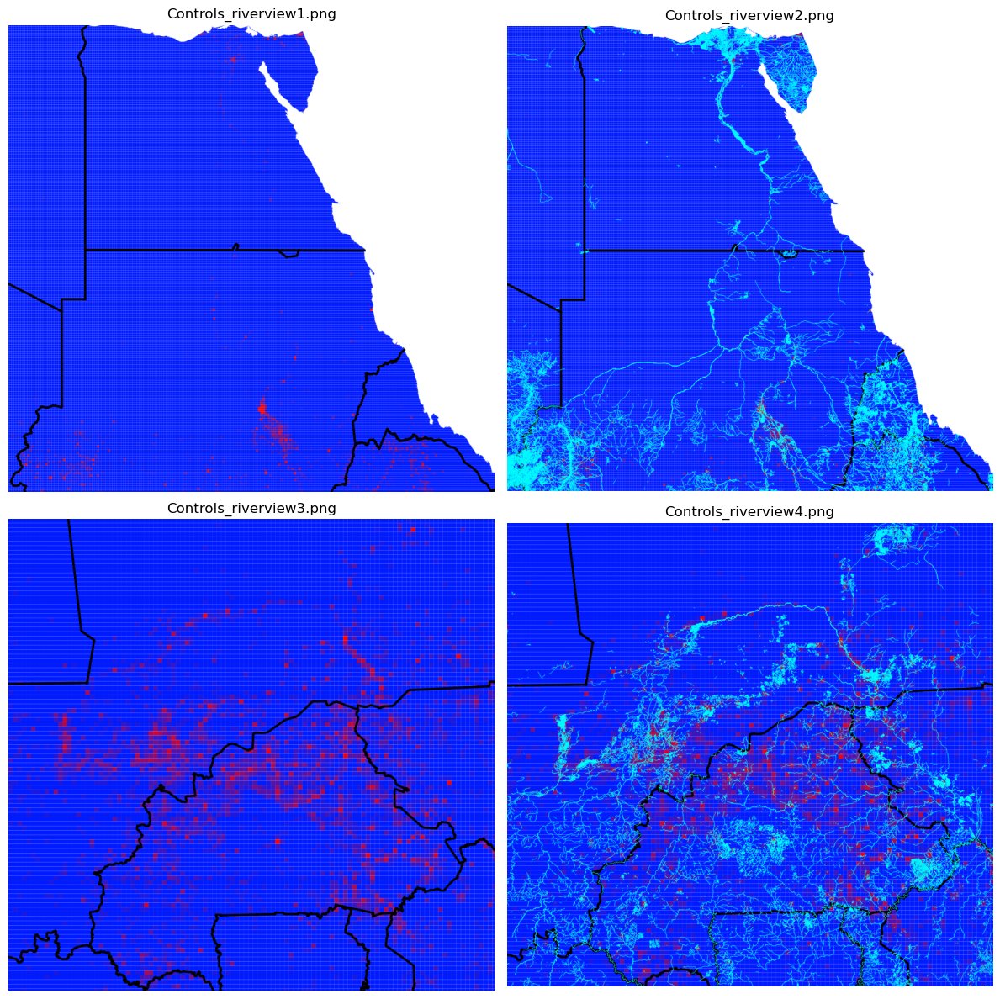

In [28]:
paths = ["../QGIS/screenshots/Controls_riverview1.png","../QGIS/screenshots/Controls_riverview2.png","../QGIS/screenshots/Controls_riverview3.png","../QGIS/screenshots/Controls_riverview4.png"]
imgs = [PILImage.open(p) for p in paths]
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
axes = axes.ravel()
for ax, img, p in zip(axes, imgs, paths):
    ax.imshow(img)
    ax.axis("off")
    ax.set_title(p.split("/")[-1])
plt.tight_layout()
plt.show()